In [ ]:
import json
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib as mpl
import numpy as np
import scipy as sp
from matplotlib import gridspec as mpgs
from skimage import transform as skt
import os
import time
import multiprocessing as mp
import skimage.filters as skf
from scipy import ndimage as scnd
import hdf5storage as h5
from matplotlib_scalebar.scalebar import ScaleBar,SI_LENGTH_RECIPROCAL
from matplotlib.offsetbox import AnchoredText
import math
import numba
import sys
import dask
import dask.array as da
import stemtool as st
%matplotlib inline
plt.rcParams['image.cmap'] = 'magma'
plt.rcParams.update({'font.size': 25})
plt.rcParams.update({'font.weight': 'bold'})

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
st.tic()
datRhPt = h5.loadmat('/home/cades/Data4D/Test_Data/RhPtThick.mat')
st.toc()

Elapsed time: 44.685131 seconds.



In [5]:
from dask.distributed import Client, LocalCluster
cluster = LocalCluster(memory_limit='auto', threads_per_worker=8)
client = Client(cluster)
client

Client Scheduler: tcp://127.0.0.1:41889 Dashboard: http://127.0.0.1:8787/status,Cluster Workers: 10 Cores: 80 Memory: 523.10 GB


In [6]:
st.tic()
json1 = '/home/cades/Data4D/Test_Data/Particle1_ACSTEM_00.json'
with open(json1) as json_1:
    info_1 = json.load(json_1)
st.toc()

Elapsed time: 0.002879 seconds.



In [7]:
calib1 = info_1['spatial_calibrations'][0]['scale']
calib1_units = info_1['spatial_calibrations'][0]['units']

In [8]:
datRhPt.keys()

dict_keys(['particle1_00', 'particle1_90', 'particle1_SP', 'particle1_im', 'particle2_00', 'particle2_90', 'particle2_SP', 'particle2_im'])

In [9]:
image00 = datRhPt['particle1_00']
image90 = datRhPt['particle1_90']
imageDC = datRhPt['particle1_im']

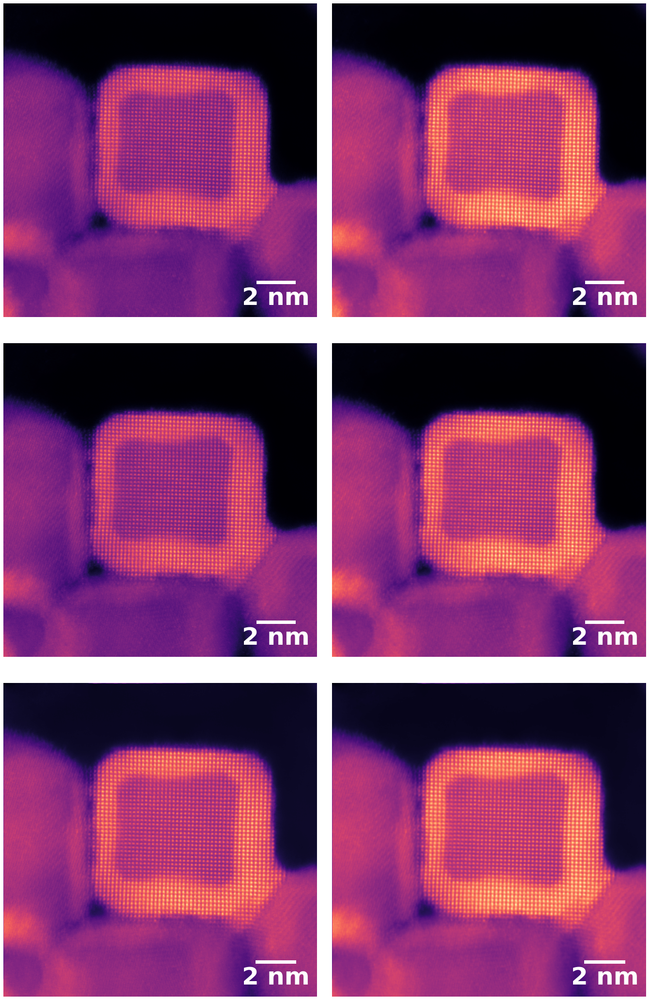

In [10]:
font = {'weight' : 'bold',
        'size'   : 50}

mpl.rc('font', **font)
plt.figure(figsize=(20,30))

plt.subplot(3,2,1)
plt.imshow(scnd.rotate(image00,90))
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.subplot(3,2,2)
plt.imshow(scnd.gaussian_filter(scnd.rotate(image00,90),2))
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.subplot(3,2,3)
plt.imshow(image90)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.subplot(3,2,4)
plt.imshow(scnd.gaussian_filter(image90,2))
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.subplot(3,2,5)
plt.imshow(scnd.rotate(imageDC,90))
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.subplot(3,2,6)
plt.imshow(scnd.gaussian_filter(scnd.rotate(imageDC,90),2))
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.tight_layout()

To ensure only the nanoparticle is picked, we will do a digital selected area electron diffraction - we will pick two diffraction spots and then mask the image so that we will analyze only the image where the diffraction spots came from.

In [11]:
image00 = scnd.gaussian_filter(scnd.rotate(image00,90),2)
image90 = scnd.gaussian_filter(image90,2)
imageDC = scnd.rotate(imageDC,90)

In [12]:
imageDC.shape

(1970, 1970)

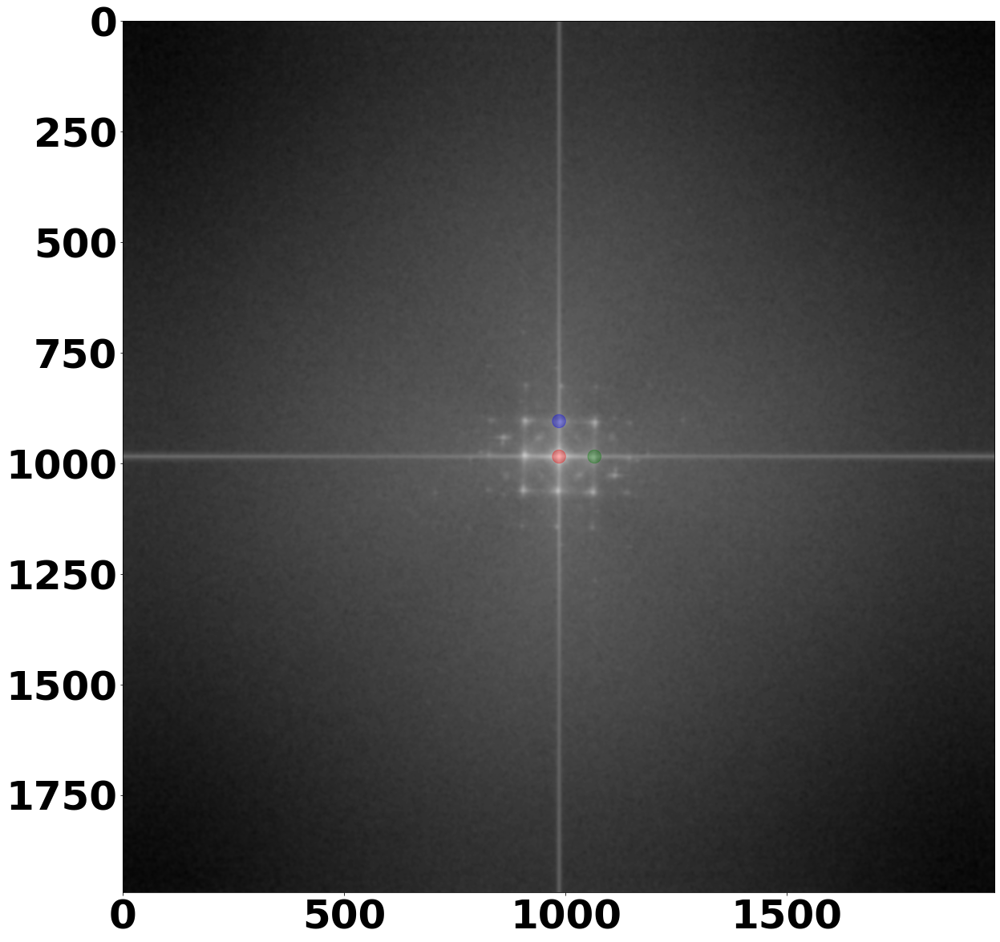

In [13]:
st.afit.find_diffraction_spots(image=imageDC,
                               circ_c=(985,985),
                               circ_y=(985,905),
                               circ_x=(1065,985))

In [14]:
st.tic()
imDC_000, ftDC_000, centerDC_000, maskDC_000 = st.afit.fourier_mask(imageDC,(985,985),30,0.1)
imDC_020, ftDC_020, centerDC_020, maskDC_020 = st.afit.fourier_mask(imageDC,(985,905),30,0.1)
imDC_200, ftDC_200, centerDC_200, maskDC_200 = st.afit.fourier_mask(imageDC,(1065,985),30,0.1)
st.toc()

Elapsed time: 15.056463 seconds.



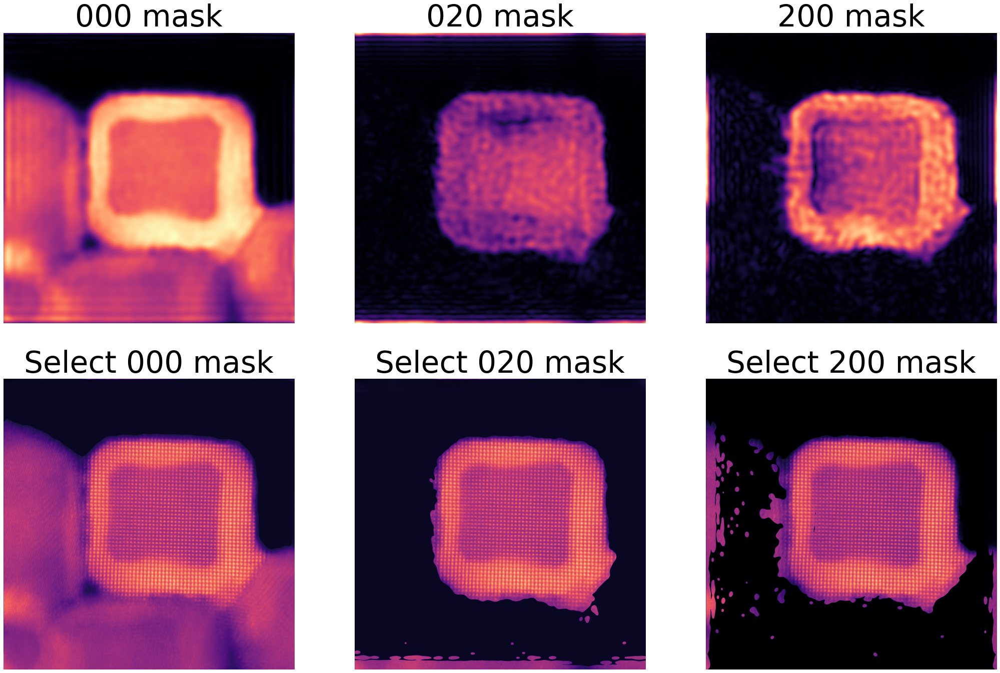

In [15]:
plt.figure(figsize=(30, 20))
plt.subplot(2,3,1)
plt.imshow(np.abs(ftDC_000))
plt.title('000 mask')
plt.axis('off')

plt.subplot(2,3,2)
plt.imshow(np.abs(ftDC_020))
plt.title('020 mask')
plt.axis('off')

plt.subplot(2,3,3)
plt.imshow(np.abs(ftDC_200))
plt.title('200 mask')
plt.axis('off')

plt.subplot(2,3,4)
plt.imshow(imDC_000)
plt.title('Select 000 mask')
plt.axis('off')

plt.subplot(2,3,5)
plt.imshow(imDC_020)
plt.title('Select 020 mask')
plt.axis('off')

plt.subplot(2,3,6)
plt.imshow(imDC_200)
plt.title('Select 200 mask')
plt.axis('off')

plt.tight_layout()

We will go with the outcome of the 200 mask.

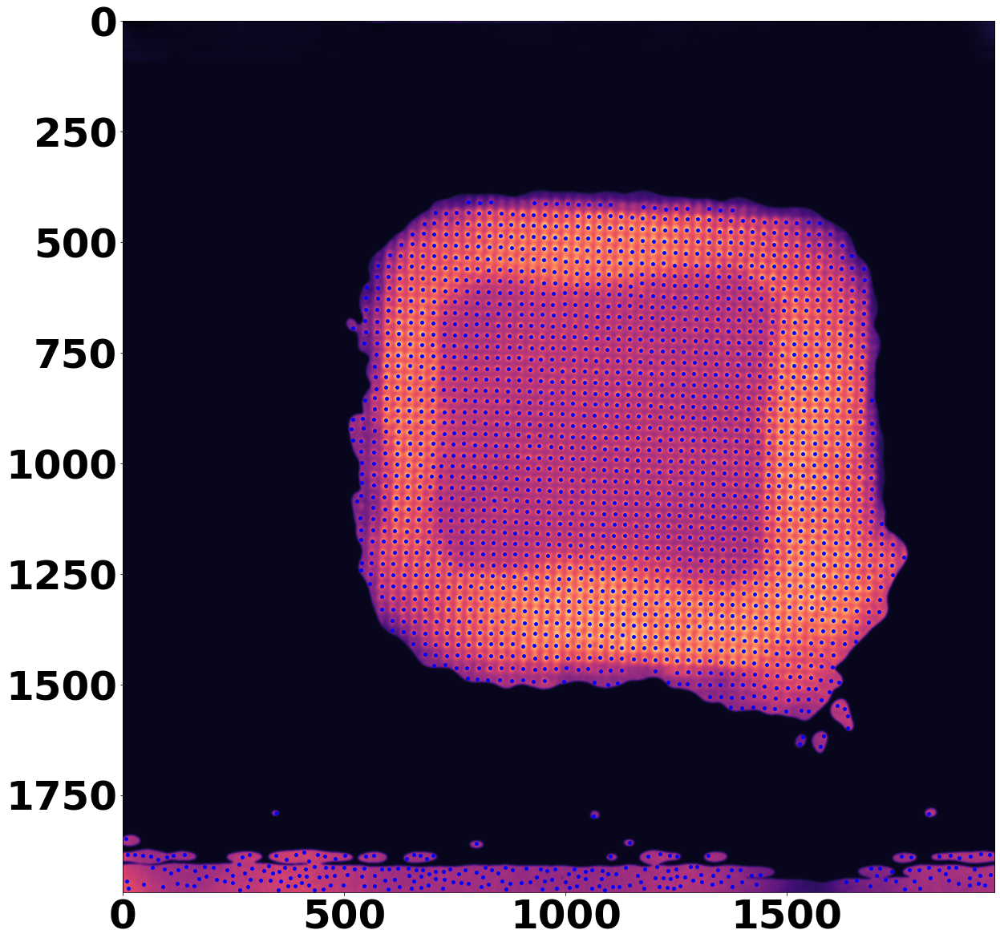

In [16]:
imDC_peaks = st.afit.peaks_vis(scnd.gaussian_filter(imDC_020,2),15,0.3)

We can now delete the edge cases

(-0.5, 1969.5, 1969.5, -0.5)

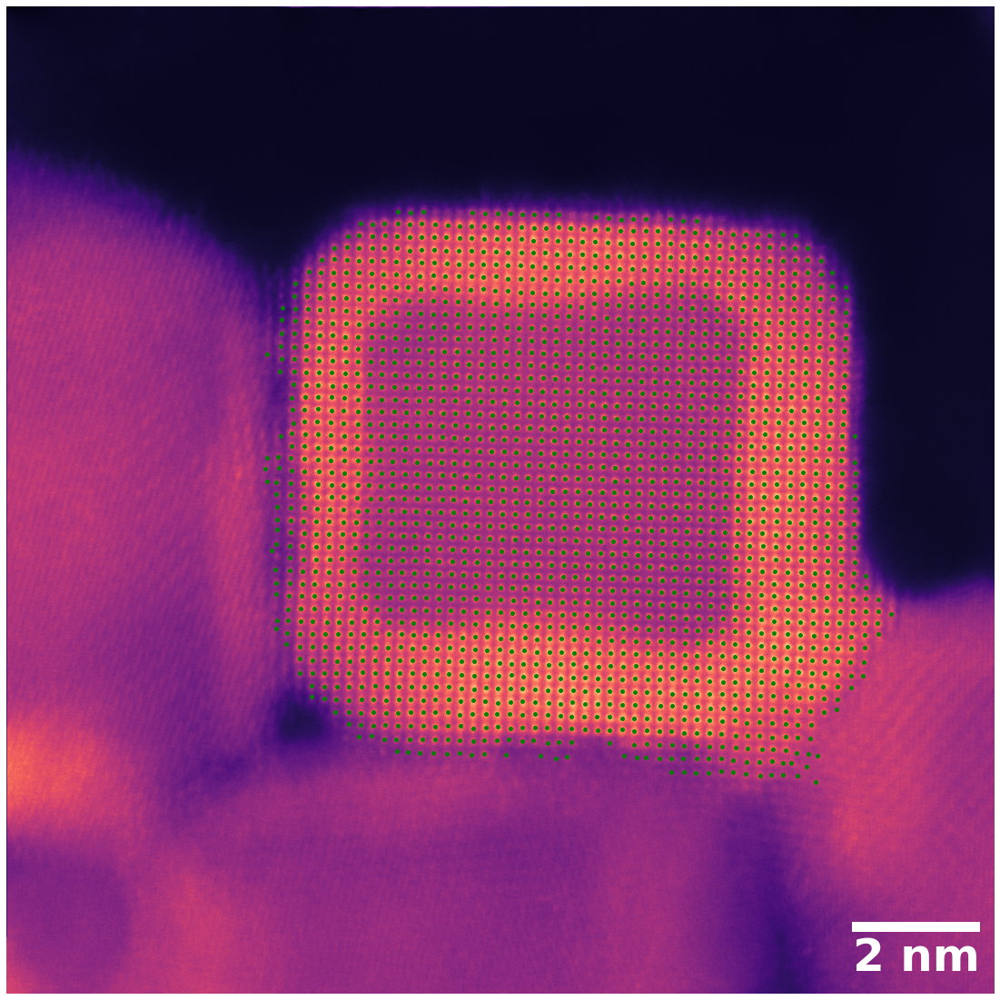

In [17]:
imageDC_peaks = np.copy(imDC_peaks)
imageDC_peaks = imageDC_peaks[imageDC_peaks[:,0] < 1550]
plt.figure(figsize=(20,20))
plt.imshow(imageDC)
plt.scatter(imageDC_peaks[:,1],imageDC_peaks[:,0],c='g', s=15)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

In [18]:
imageDC_peaks.shape

(1954, 2)

We run refine_atoms on a small subset of the data to precompile the code with numba. This considerably speeds up the final code when it runs on the full dataset.

In [19]:
@numba.jit(cache=True,parallel=True)
def refine_atoms_numba(image_data,
                       positions):
    dist = np.zeros(len(positions))
    image_data = st.util.image_normalizer(image_data)
    for ii in np.arange(len(positions)):
        ccd = np.sum(((positions[:,0:2] - positions[ii,0:2]) ** 2),axis=1)
        dist[ii] = (np.amin(ccd[ccd > 0])) ** 0.5
    distance = np.median(dist)/2
    no_of_points = positions.shape[0]
    refined_pos = (np.zeros((no_of_points,6))).astype(float)
    for ii in numba.prange(no_of_points):
        pos_x = (positions[ii,1]).astype(float)
        pos_y = (positions[ii,0]).astype(float)
        fitted_diff = st.util.fit_gaussian2D_mask(1+image_data,pos_x,pos_y,distance)
        refined_pos[ii,1] = fitted_diff[0]
        refined_pos[ii,0] = fitted_diff[1]
        refined_pos[ii,2:6] = fitted_diff[2:6]
        refined_pos[ii,-1] = fitted_diff[-1] - 1
    return refined_pos

In [20]:
%timeit refine_atoms_numba(imageDC,imageDC_peaks[0:20,:])

4.2 s ± 10.8 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [21]:
st.tic()
imageDC_rpeaks = refine_atoms_numba(imageDC,imageDC_peaks)
st.toc()

Elapsed time: 406.102660 seconds.



In [22]:
@dask.delayed
def refine_atom_dask(image_data,image_pos,distance):
    pos_x = (image_pos[1]).astype(float)
    pos_y = (image_pos[0]).astype(float)
    fitted_diff = st.util.fit_gaussian2D_mask(1+st.util.image_normalizer(image_data),pos_x,pos_y,distance)
    fitted_pos = np.copy(fitted_diff)
    fitted_pos[0:2] = np.flip(fitted_diff[0:2])
    fitted_pos[-1] = fitted_diff[-1] - 1
    return fitted_pos

@dask.delayed
def get_dist_dask(image_pos,positions):
    ccd = np.sum(((positions[:,0:2] - image_pos) ** 2),axis=1)
    dist = (np.amin(ccd[ccd > 0])) ** 0.5
    return dist

def refine_atoms(image_data,
                 positions):
    dist = []
    for jj in range(len(positions)):
        q = get_dist_dask(positions[jj,:],positions)
        dist.append(q)
    dist = dask.compute(*dist)
    med_dist = np.median(np.asarray(dist))/2
    refined_pos = []
    for ii in range(len(positions)):
        p = refine_atom_dask(image_data,positions[ii,:],med_dist)
        refined_pos.append(p)
    refined_pos = dask.compute(*refined_pos)
    return np.asarray(refined_pos)

In [23]:
st.tic()
imageDC_dpeaks = refine_atoms(imageDC,imageDC_peaks)
st.toc()

Elapsed time: 466.557758 seconds.



In [42]:
import jax
import jax.numpy as np
from jax.ops import index, index_add, index_update

@jax.jit
def refine_atoms_numpy(image_data,
                       positions):
    dist = np.zeros(len(positions))
    for ii in np.arange(len(positions)):
        ccd = np.sum(((positions[:,0:2] - positions[ii,0:2]) ** 2),axis=1)
        ccd = index_update(ccd, index[ii], np.amax(ccd))
        dist = index_update(dist, index[ii], np.amin(ccd) ** 0.5)
    distance = np.median(dist)/2
    no_of_points = positions.shape[0]
    refined_pos = np.zeros((no_of_points,6),dtype=np.float32)
    for ii in range(no_of_points):
        pos_x = (positions[ii,1]).astype(np.float32)
        pos_y = (positions[ii,0]).astype(np.float32)
        fitted_diff = st.util.fit_gaussian2D_mask(1+image_data,pos_x,pos_y,distance)
        refined_pos[ii,0:2] = np.flip(fitted_diff[0:2])
        refined_pos[ii,2:6] = fitted_diff[2:6]
        refined_pos[ii,-1] = fitted_diff[-1] - 1
    return refined_pos

In [43]:
%timeit refine_atoms_numpy(imageDC,imageDC_peaks[0:50,:])

Exception: Tracer can't be used with raw numpy functions. You might have
  import numpy as np
instead of
  import jax.numpy as np

In [25]:
st.tic()
imageDC_npeaks = refine_atoms_numpy(imageDC,imageDC_peaks)
st.toc()

Elapsed time: 353.039618 seconds.



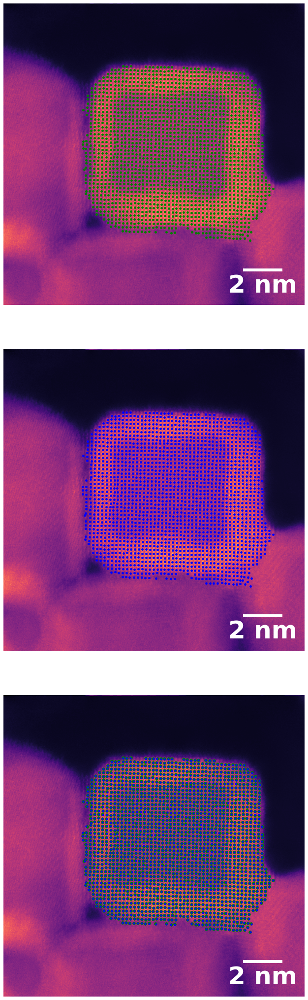

In [20]:
plt.figure(figsize=(10,30))

plt.subplot(3,1,1)
plt.imshow(imageDC)
plt.scatter(imageDC_peaks[:,1],imageDC_peaks[:,0],c='g', s=15)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.subplot(3,1,2)
plt.imshow(imageDC)
plt.scatter(imageDC_rpeaks[:,1],imageDC_rpeaks[:,0],c='b', s=15)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.subplot(3,1,3)
plt.imshow(imageDC)
plt.scatter(imageDC_peaks[:,1],imageDC_peaks[:,0],c='g', s=30)
plt.scatter(imageDC_rpeaks[:,1],imageDC_rpeaks[:,0],c='b', s=10)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.tight_layout()

plt.savefig('Results_ADF/Particle1_DC_Peaks_Fitted.pdf',bbox_inches='tight')

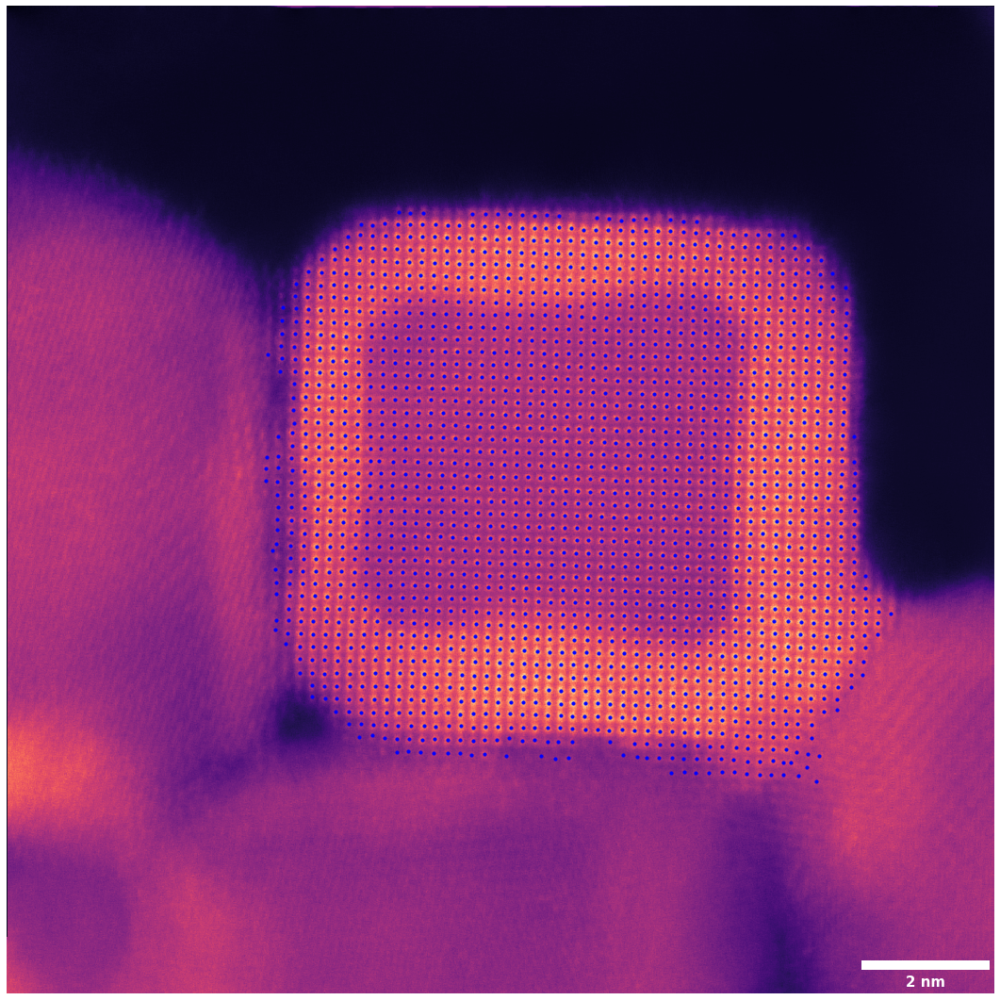

In [21]:
font = {'weight' : 'bold',
        'size'   : 15}

mpl.rc('font', **font)
plt.figure(figsize=(15,15))
plt.imshow(imageDC)
plt.scatter(imageDC_rpeaks[:,1],imageDC_rpeaks[:,0],c='b', s=10)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.tight_layout()
plt.savefig('Results_ADF/Particle1_DC_Fitted.pdf',bbox_inches='tight')

In [22]:
st.tic()
imageDC_coords = st.afit.find_coords(imageDC,centerDC_000,centerDC_200,centerDC_020,np.asarray((1,0,0)),np.asarray((0,1,0)))
st.toc()

Elapsed time: 0.001551 seconds.



In [23]:
imageDC_coords

array([[25.49862952, -0.54007901],
       [-0.57318792, 25.34932496]])

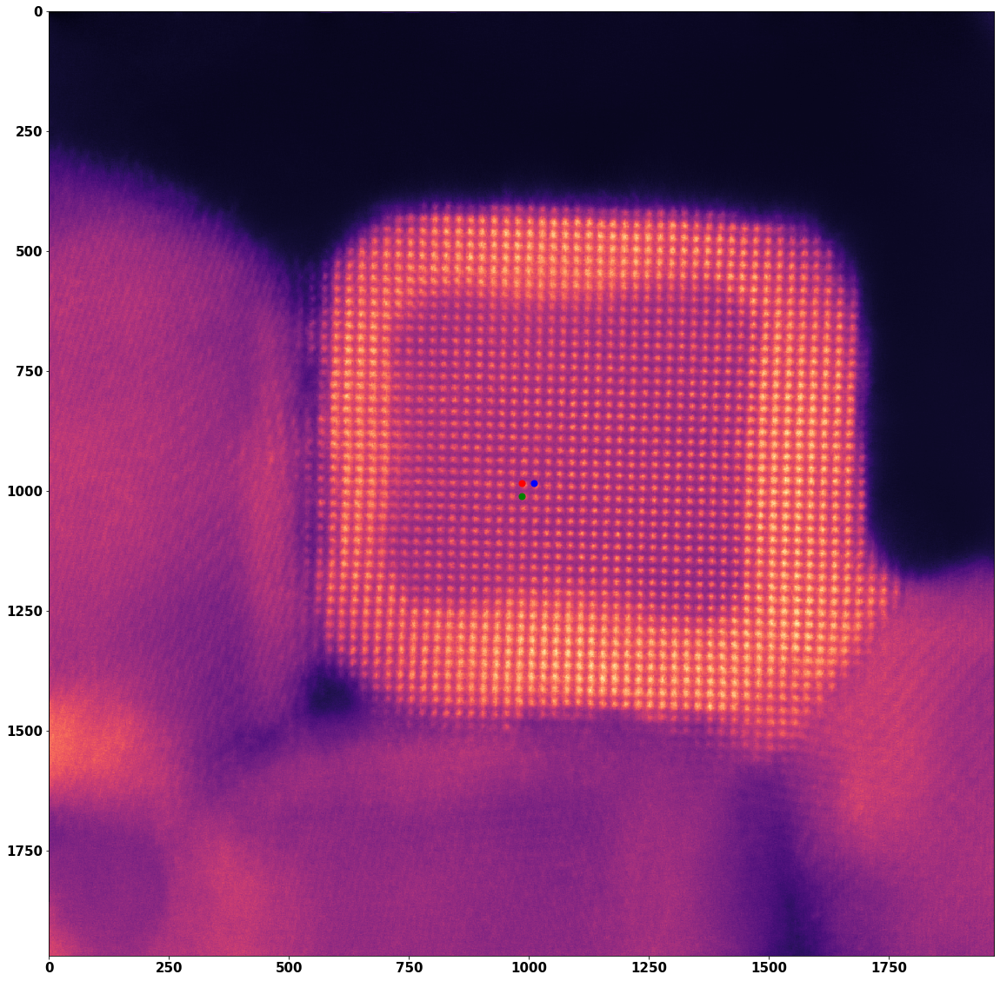

In [24]:
plt.figure(figsize=(20,20))
plt.imshow(imageDC)
plt.scatter(imageDC.shape[1]/2,imageDC.shape[0]/2,c='r', s=50)
plt.scatter(imageDC.shape[1]/2 + imageDC_coords[0,1],imageDC.shape[0]/2 + imageDC_coords[0,0],c='g', s=50)
plt.scatter(imageDC.shape[1]/2 + imageDC_coords[1,1],imageDC.shape[0]/2 + imageDC_coords[1,0],c='b', s=50)

In [25]:
axisDC_origin = st.afit.get_origin(imageDC,imageDC_rpeaks,imageDC_coords)

In [26]:
st.tic()
imageDC_neigh, imageDC_ndist = st.afit.three_neighbors(imageDC_rpeaks,imageDC_coords,0.33)
st.toc()

Elapsed time: 8.745502 seconds.



In [27]:
st.tic()
imageDC_centers, imageDC_yy,imageDC_xx,imageDC_xy,imageDC_th = st.afit.relative_strain(imageDC_neigh,imageDC_coords)
st.toc()

Elapsed time: 5.552170 seconds.



In [28]:
imageDC_yy = imageDC_yy - np.median(imageDC_yy)
imageDC_xx = imageDC_xx - np.median(imageDC_xx)
imageDC_xy = imageDC_xy - np.median(imageDC_xy)
imageDC_th = imageDC_th - np.median(imageDC_th)

In [29]:
st.tic()
strainDC_yy,strainDC_xx,strainDC_xy,strainDC_th = st.afit.strain_map(imageDC_centers,
                                                                     imageDC_yy,
                                                                     imageDC_xx, 
                                                                     imageDC_xy,
                                                                     imageDC_th,
                                                                     maskDC_200)
st.toc()

Elapsed time: 0.943704 seconds.



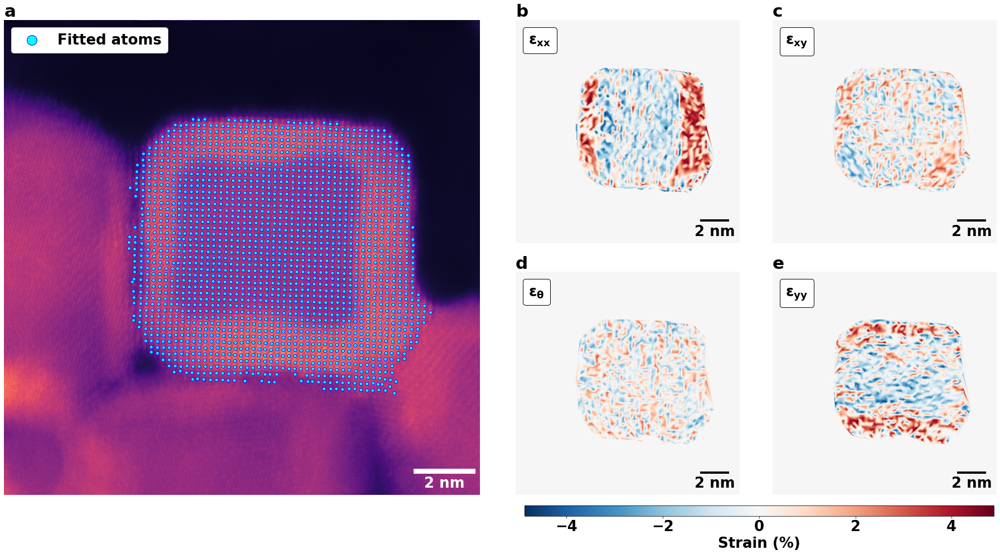

In [76]:
vm = 100*np.amax(np.abs(np.concatenate((strainDC_yy,strainDC_xx,strainDC_xy,strainDC_th),axis=1)))
font_size = int(26)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

fig =plt.figure(figsize=(26,13))

gs = mpgs.GridSpec(2, 4)
ax1 = plt.subplot(gs[:, 0:2])
ax2 = plt.subplot(gs[0, 2])
ax3 = plt.subplot(gs[0, 3])
ax4 = plt.subplot(gs[1, 2])
ax5 = plt.subplot(gs[1, 3])

ax1.imshow(imageDC)
ax1.scatter(imageDC_rpeaks[:,1],imageDC_rpeaks[:,0],c='aqua',edgecolors='b',s=35,label='Fitted atoms')
ax1.legend(loc='upper left',markerscale=3,framealpha=1)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
ax1.add_artist(scalebar)
ax1.set_title(label='a',loc='left',fontdict=title_font)
ax1.axis('off')

im = ax2.imshow(100*strainDC_xx,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax2.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{xx}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax2.add_artist(at)
ax2.set_title(label='b',loc='left',fontdict=title_font)
ax2.axis('off')


im = ax3.imshow(100*strainDC_xy,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax3.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{xy}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax3.add_artist(at)
ax3.set_title(label='c',loc='left',fontdict=title_font)
ax3.axis('off')


im = ax4.imshow(100*strainDC_th,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax4.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{\theta}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax4.add_artist(at)
ax4.set_title(label='d',loc='left',fontdict=title_font)
ax4.axis('off')


im = ax5.imshow(100*strainDC_yy,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax5.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{yy}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax5.add_artist(at)
ax5.set_title(label='e',loc='left',fontdict=title_font)
ax5.axis('off')

p4 = ax4.get_position().get_points().flatten()
p5 = ax5.get_position().get_points().flatten()

ax_cbar = fig.add_axes([p4[0] - 0.005, -0.01, 0.5*p5[2], 0.02])
cbar = plt.colorbar(im, cax=ax_cbar, orientation='horizontal')
cbar.set_label('Strain (%)',**sc_font)

plt.tight_layout()
plt.savefig('Results_ADF/Particle1_DC_Strain_ACSTEM.pdf',bbox_inches='tight')

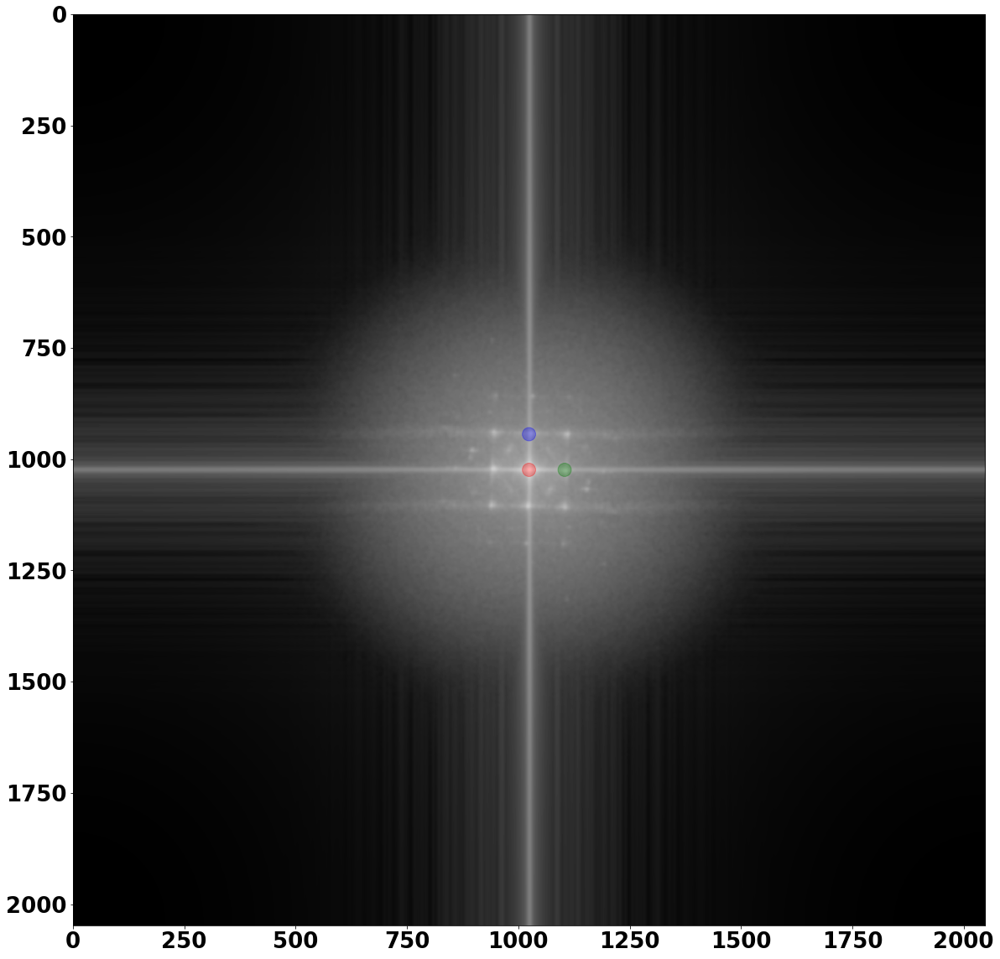

In [31]:
st.afit.find_diffraction_spots(image=image00,
                               circ_c=(1024,1024),
                               circ_y=(1024,944),
                               circ_x=(1104,1024))

In [32]:
st.tic()
im00_000, ft00_000, center00_000, mask00_000 = st.afit.fourier_mask(image00,(1024,1024),30,0.1)
im00_020, ft00_020, center00_020, mask00_020 = st.afit.fourier_mask(image00,(1024,944),30,0.1)
im00_200, ft00_200, center00_200, mask00_200 = st.afit.fourier_mask(image00,(1104,1024),30,0.1)
st.toc()

Elapsed time: 5.798994 seconds.



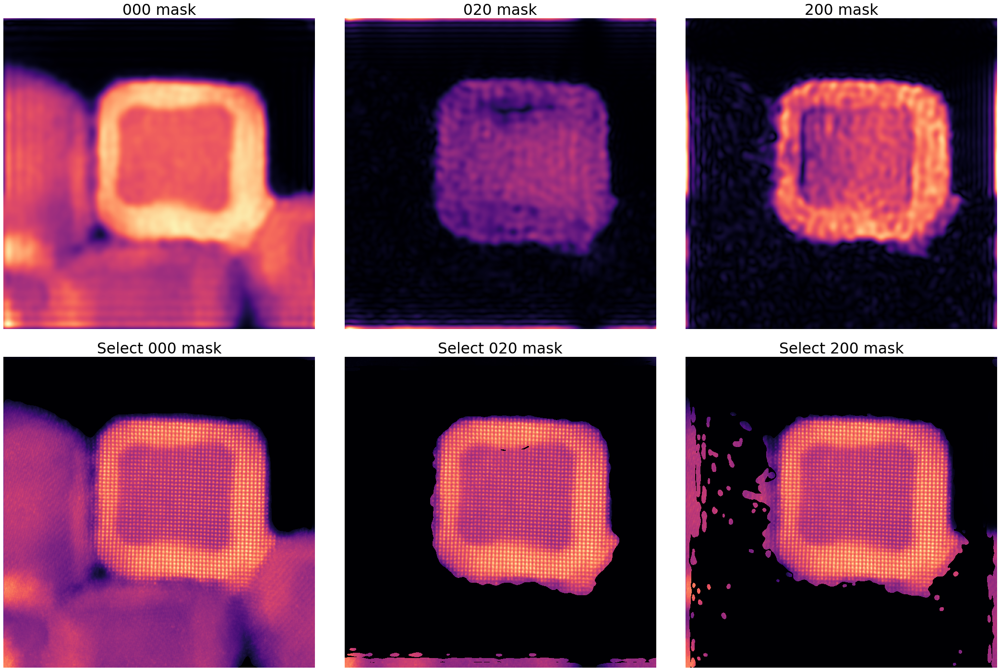

In [33]:
plt.figure(figsize=(30, 20))
plt.subplot(2,3,1)
plt.imshow(np.abs(ft00_000))
plt.title('000 mask')
plt.axis('off')

plt.subplot(2,3,2)
plt.imshow(np.abs(ft00_020))
plt.title('020 mask')
plt.axis('off')

plt.subplot(2,3,3)
plt.imshow(np.abs(ft00_200))
plt.title('200 mask')
plt.axis('off')

plt.subplot(2,3,4)
plt.imshow(im00_000)
plt.title('Select 000 mask')
plt.axis('off')

plt.subplot(2,3,5)
plt.imshow(im00_020)
plt.title('Select 020 mask')
plt.axis('off')

plt.subplot(2,3,6)
plt.imshow(im00_200)
plt.title('Select 200 mask')
plt.axis('off')

plt.tight_layout()

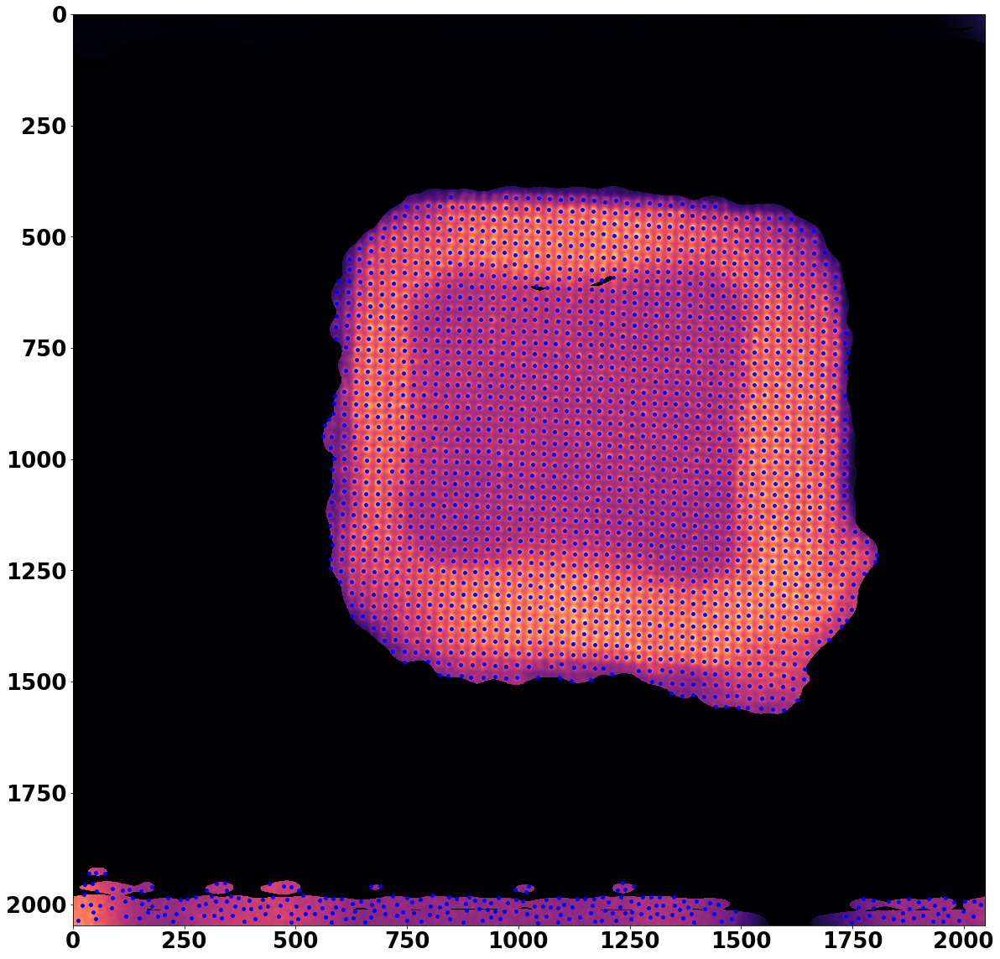

In [34]:
im00_peaks = st.afit.peaks_vis(im00_020,15,0.25)

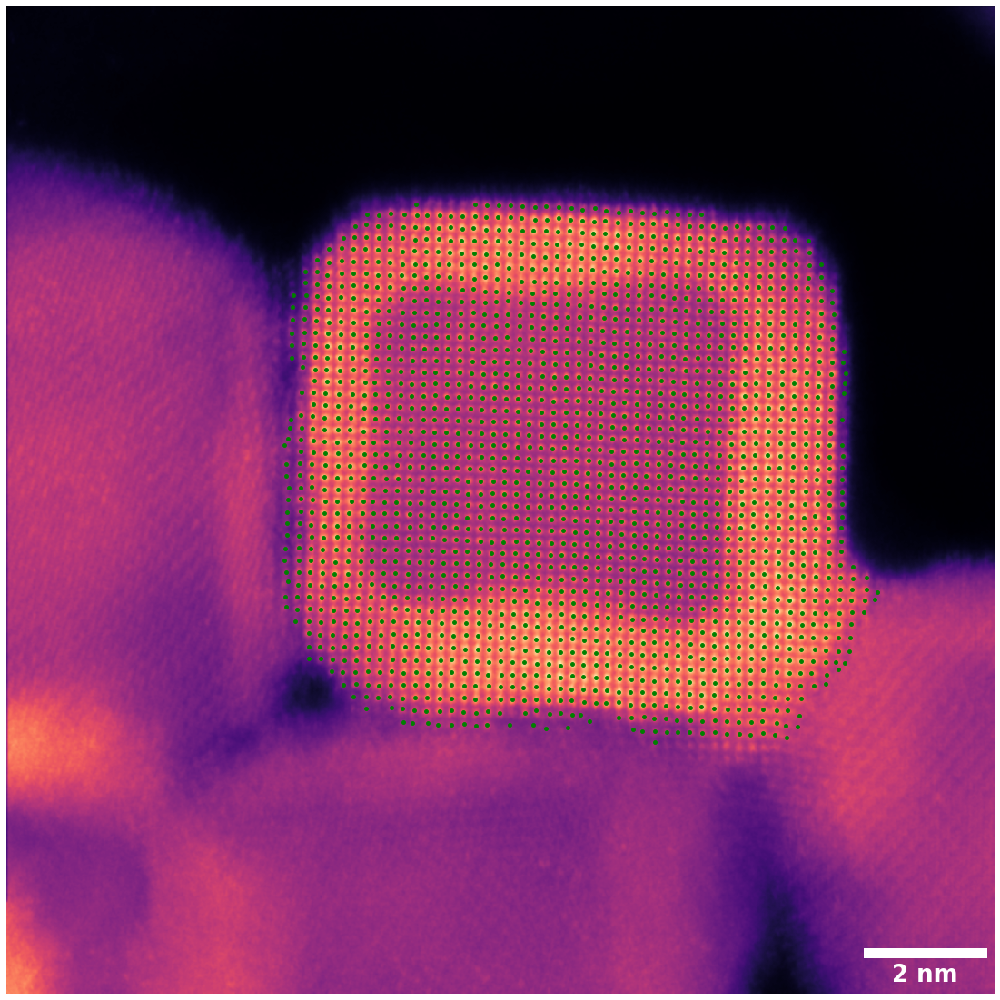

In [35]:
image00_peaks = np.copy(im00_peaks)
image00_peaks = image00_peaks[image00_peaks[:,0] > 350]
image00_peaks = image00_peaks[image00_peaks[:,0] < 1530]
image00_peaks = image00_peaks[image00_peaks[:,1] > 570]
plt.figure(figsize=(20,20))
plt.imshow(image00)
plt.scatter(image00_peaks[:,1],image00_peaks[:,0],c='g', s=15)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.savefig('Results_ADF/Particle1_00_Peaks.pdf',bbox_inches='tight')

In [36]:
image00_peaks.shape

(1945, 2)

In [37]:
%timeit st.afit.refine_atoms(image00,image00_peaks[0:20,:])

2.51 s ± 25.1 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [38]:
st.tic()
image00_rpeaks = st.afit.refine_atoms(image00,image00_peaks)
st.toc()

Elapsed time: 256.089100 seconds.



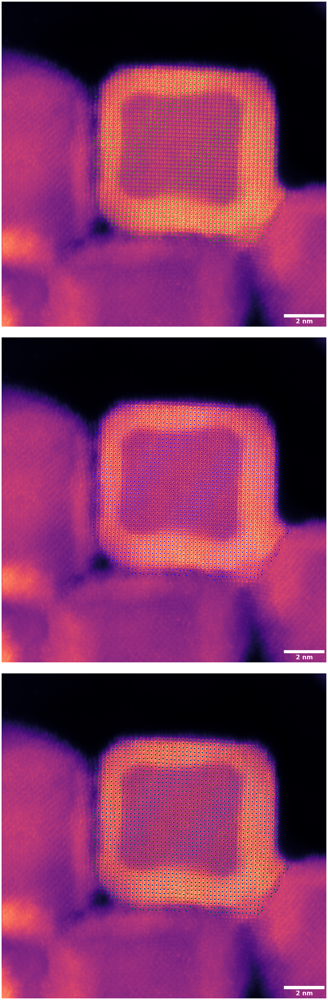

In [39]:
plt.figure(figsize=(20,60))

plt.subplot(3,1,1)
plt.imshow(image00)
plt.scatter(image00_peaks[:,1],image00_peaks[:,0],c='g', s=15)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.subplot(3,1,2)
plt.imshow(image00)
plt.scatter(image00_rpeaks[:,1],image00_rpeaks[:,0],c='b', s=15)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.subplot(3,1,3)
plt.imshow(image00)
plt.scatter(image00_peaks[:,1],image00_peaks[:,0],c='g', s=30)
plt.scatter(image00_rpeaks[:,1],image00_rpeaks[:,0],c='b', s=10)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.tight_layout()

plt.savefig('Results_ADF/Particle1_00_Peaks_Fitted.pdf',bbox_inches='tight')

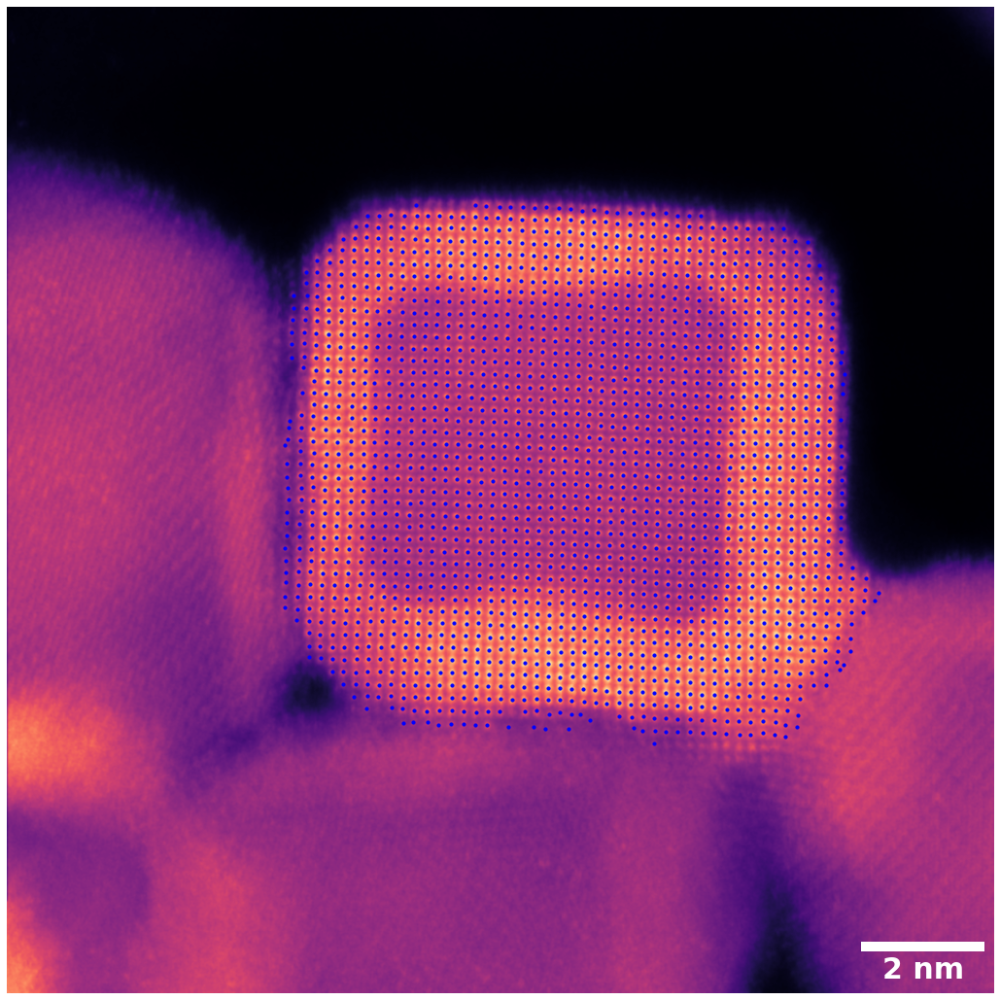

In [40]:
font = {'weight' : 'bold',
        'size'   : 30}

mpl.rc('font', **font)
plt.figure(figsize=(15,15))
plt.imshow(image00)
plt.scatter(image00_rpeaks[:,1],image00_rpeaks[:,0],c='b', s=10)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.tight_layout()
plt.savefig('Results_ADF/Particle1_00_Fitted.pdf',bbox_inches='tight')

In [41]:
st.tic()
image00_coords = st.afit.find_coords(image00,center00_000,center00_200,center00_020,np.asarray((1,0,0)),np.asarray((0,1,0)))
st.toc()

Elapsed time: 0.001340 seconds.



In [42]:
image00_coords

array([[25.6707803 , -0.45466066],
       [-0.60117278, 25.61426984]])

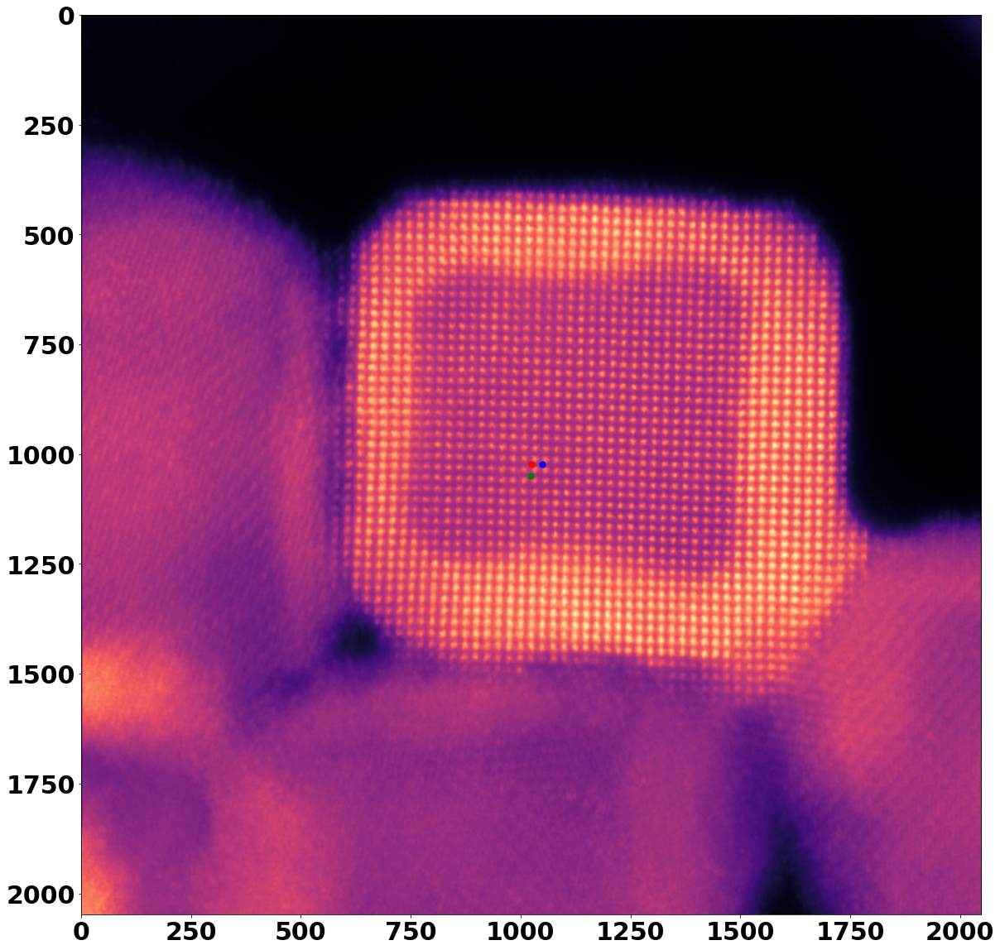

In [43]:
plt.figure(figsize=(20,20))
plt.imshow(image00)
plt.scatter(image00.shape[1]/2,image00.shape[0]/2,c='r', s=50)
plt.scatter(image00.shape[1]/2 + image00_coords[0,1],image00.shape[0]/2 + image00_coords[0,0],c='g', s=50)
plt.scatter(image00.shape[1]/2 + image00_coords[1,1],image00.shape[0]/2 + image00_coords[1,0],c='b', s=50)

In [44]:
axis00_origin = st.afit.get_origin(image00,image00_rpeaks,image00_coords)

In [45]:
st.tic()
image00_neigh, image00_ndist = st.afit.three_neighbors(image00_rpeaks,image00_coords,0.33)
st.toc()

Elapsed time: 0.885776 seconds.



In [46]:
st.tic()
image00_centers, image00_yy,image00_xx,image00_xy,image00_th = st.afit.relative_strain(image00_neigh,image00_coords)
st.toc()

Elapsed time: 0.329659 seconds.



In [47]:
image00_yy = image00_yy - np.median(image00_yy)
image00_xx = image00_xx - np.median(image00_xx)
image00_xy = image00_xy - np.median(image00_xy)
image00_th = image00_th - np.median(image00_th)

In [48]:
st.tic()
strain00_yy,strain00_xx,strain00_xy,strain00_th = st.afit.strain_map(image00_centers,
                                                                     image00_yy,
                                                                     image00_xx, 
                                                                     image00_xy,
                                                                     image00_th,
                                                                     mask00_020)
st.toc()

Elapsed time: 1.119052 seconds.



In [ ]:
vm = 100*np.amax(np.abs(np.concatenate((strain00_yy,strain00_xx,strain00_xy,strain00_th),axis=1)))
font_size = int(26)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

fig =plt.figure(figsize=(26,13))

gs = mpgs.GridSpec(2, 4)
ax1 = plt.subplot(gs[:, 0:2])
ax2 = plt.subplot(gs[0, 2])
ax3 = plt.subplot(gs[0, 3])
ax4 = plt.subplot(gs[1, 2])
ax5 = plt.subplot(gs[1, 3])

ax1.imshow(image00)
ax1.scatter(image00_rpeaks[:,1],image00_rpeaks[:,0],c='aqua',edgecolors='b',s=35,label='Fitted atoms')
ax1.legend(loc='upper left',markerscale=3,framealpha=1)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
ax1.add_artist(scalebar)
ax1.set_title(label='a',loc='left',fontdict=title_font)
ax1.axis('off')

im = ax2.imshow(100*strain00_xx,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax2.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{xx}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax2.add_artist(at)
ax2.set_title(label='b',loc='left',fontdict=title_font)
ax2.axis('off')


im = ax3.imshow(100*strain00_xy,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax3.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{xy}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax3.add_artist(at)
ax3.set_title(label='c',loc='left',fontdict=title_font)
ax3.axis('off')


im = ax4.imshow(100*strain00_th,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax4.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{\theta}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax4.add_artist(at)
ax4.set_title(label='d',loc='left',fontdict=title_font)
ax4.axis('off')


im = ax5.imshow(100*strain00_yy,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax5.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{yy}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax5.add_artist(at)
ax5.set_title(label='e',loc='left',fontdict=title_font)
ax5.axis('off')

p4 = ax4.get_position().get_points().flatten()
p5 = ax5.get_position().get_points().flatten()

ax_cbar = fig.add_axes([p4[0] - 0.005, -0.01, 0.5*p5[2], 0.02])
cbar = plt.colorbar(im, cax=ax_cbar, orientation='horizontal')
cbar.set_label('Strain (%)',**sc_font)

plt.tight_layout()
plt.savefig('Results_ADF/Particle1_00_Strain_ACSTEM.pdf',bbox_inches='tight')

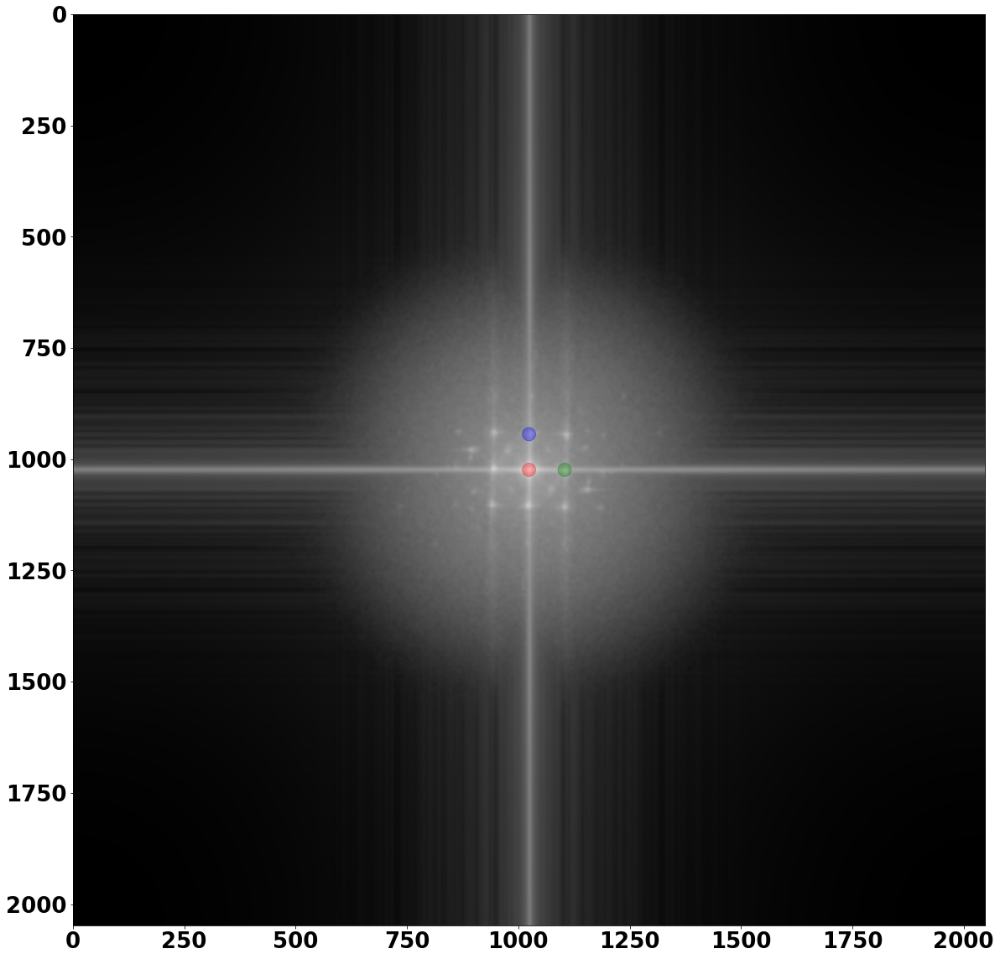

In [50]:
st.afit.find_diffraction_spots(image=image90,
                               circ_c=(1024,1024),
                               circ_y=(1024,944),
                               circ_x=(1104,1024))

In [51]:
st.tic()
im90_000, ft90_000, center90_000, mask90_000 = st.afit.fourier_mask(image90,(1024,1024),30,0.1)
im90_020, ft90_020, center90_020, mask90_020 = st.afit.fourier_mask(image90,(1024,944),30,0.05)
im90_200, ft90_200, center90_200, mask90_200 = st.afit.fourier_mask(image90,(1104,1024),30,0.05)
st.toc()

Elapsed time: 5.509615 seconds.



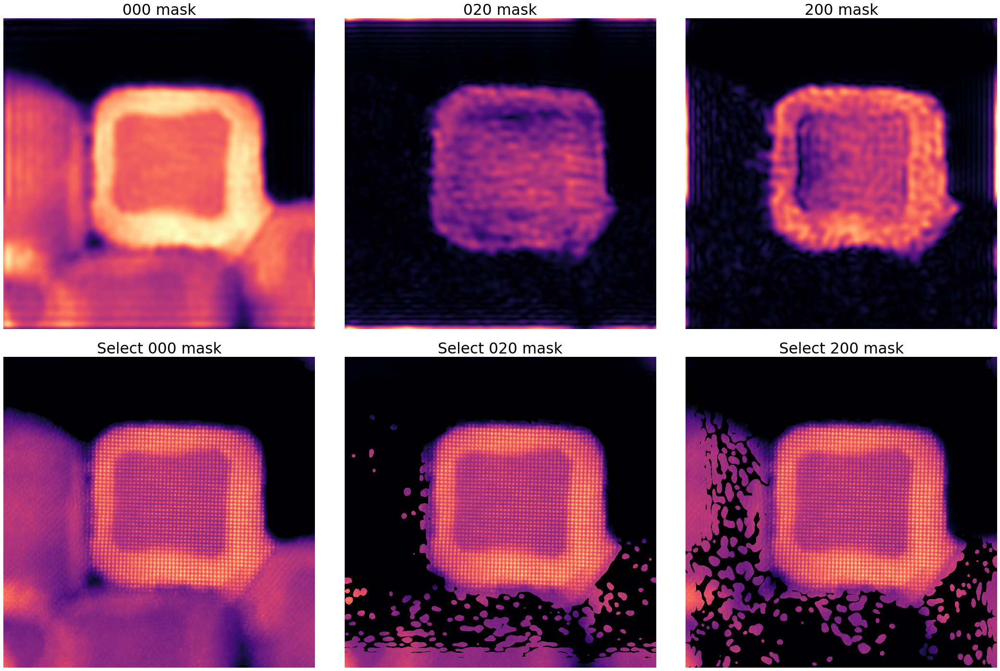

In [52]:
plt.figure(figsize=(30, 20))
plt.subplot(2,3,1)
plt.imshow(np.abs(ft90_000))
plt.title('000 mask')
plt.axis('off')

plt.subplot(2,3,2)
plt.imshow(np.abs(ft90_020))
plt.title('020 mask')
plt.axis('off')

plt.subplot(2,3,3)
plt.imshow(np.abs(ft90_200))
plt.title('200 mask')
plt.axis('off')

plt.subplot(2,3,4)
plt.imshow(im90_000)
plt.title('Select 000 mask')
plt.axis('off')

plt.subplot(2,3,5)
plt.imshow(im90_020)
plt.title('Select 020 mask')
plt.axis('off')

plt.subplot(2,3,6)
plt.imshow(im90_200)
plt.title('Select 200 mask')
plt.axis('off')

plt.tight_layout()

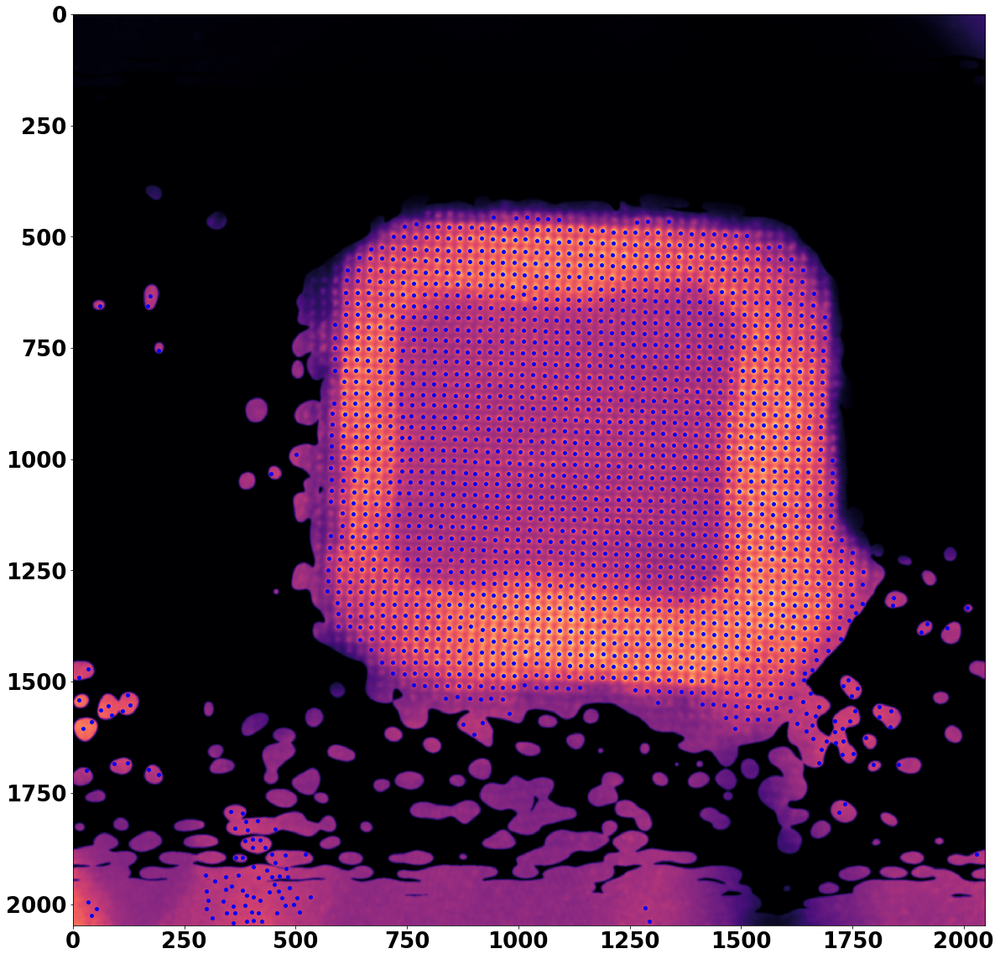

In [53]:
im90_peaks = st.afit.peaks_vis(scnd.gaussian_filter(im90_020,2),15,0.5)

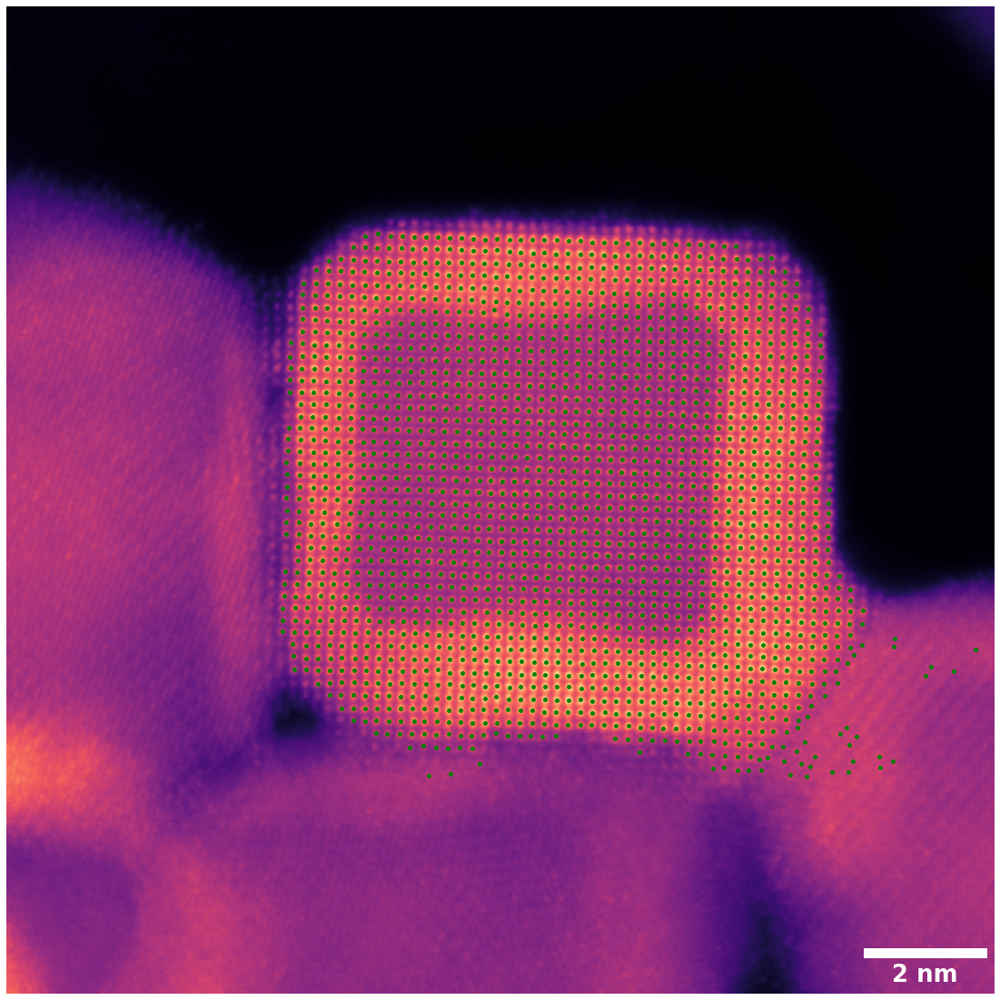

In [54]:
image90_peaks = np.copy(im90_peaks)
image90_peaks = image90_peaks[image90_peaks[:,0] > 470]
image90_peaks = image90_peaks[image90_peaks[:,0] < 1600]
image90_peaks = image90_peaks[image90_peaks[:,1] > 550]
plt.figure(figsize=(20,20))
plt.imshow(image90)
plt.scatter(image90_peaks[:,1],image90_peaks[:,0],c='g', s=15)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.savefig('Results_ADF/Particle1_90_Peaks.pdf',bbox_inches='tight')

In [55]:
image90_peaks.shape

(1895, 2)

In [56]:
%timeit st.afit.refine_atoms(image90,image90_peaks[0:20,:])

2.56 s ± 58 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [57]:
st.tic()
image90_rpeaks = st.afit.refine_atoms(image90,image90_peaks)
st.toc()

Elapsed time: 243.946142 seconds.



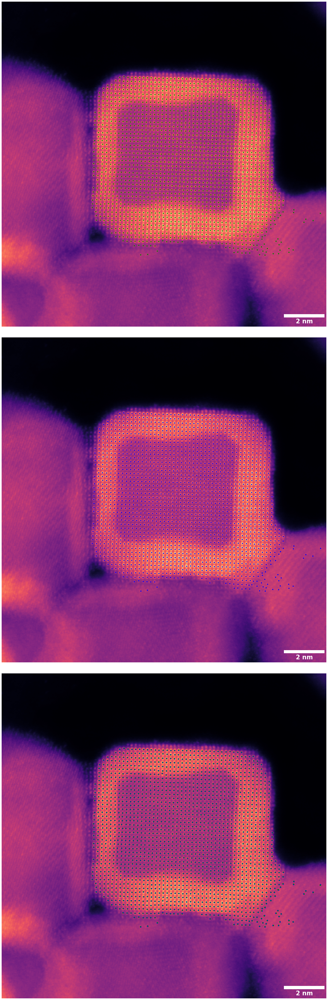

In [58]:
plt.figure(figsize=(20,60))

plt.subplot(3,1,1)
plt.imshow(image90)
plt.scatter(image90_peaks[:,1],image90_peaks[:,0],c='g', s=15)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.subplot(3,1,2)
plt.imshow(image90)
plt.scatter(image90_rpeaks[:,1],image90_rpeaks[:,0],c='b', s=15)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.subplot(3,1,3)
plt.imshow(image90)
plt.scatter(image90_peaks[:,1],image90_peaks[:,0],c='g', s=30)
plt.scatter(image90_rpeaks[:,1],image90_rpeaks[:,0],c='b', s=10)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.tight_layout()

plt.savefig('Results_ADF/Particle1_90_Peaks_Fitted.pdf',bbox_inches='tight')

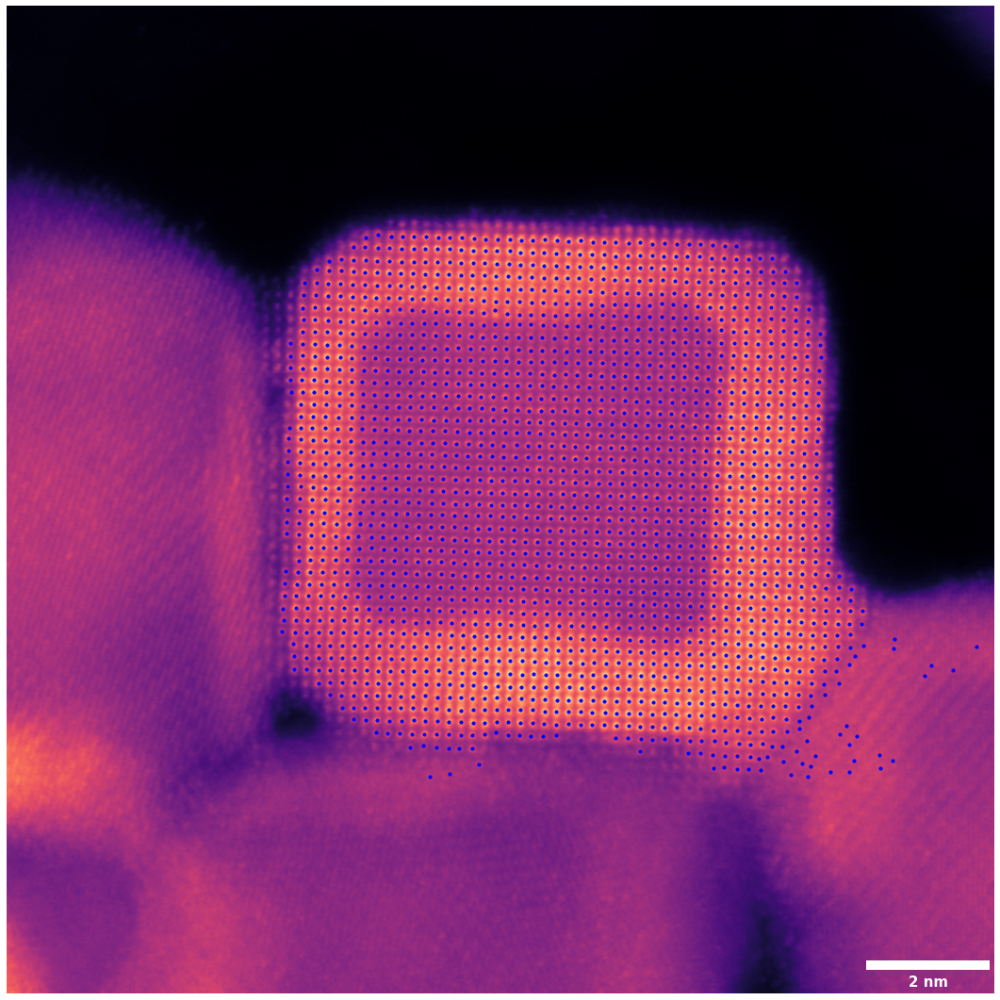

In [59]:
font = {'weight' : 'bold',
        'size'   : 15}

mpl.rc('font', **font)
plt.figure(figsize=(15,15))
plt.imshow(image90)
plt.scatter(image90_rpeaks[:,1],image90_rpeaks[:,0],c='b', s=10)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.tight_layout()
plt.savefig('Results_ADF/Particle1_90_Fitted.pdf',bbox_inches='tight')

In [60]:
st.tic()
image90_coords = st.afit.find_coords(image90,center90_000,center90_200,center90_020,np.asarray((1,0,0)),np.asarray((0,1,0)))
st.toc()

Elapsed time: 0.001331 seconds.



In [61]:
image90_coords

array([[25.68399162, -0.54920706],
       [-0.54182533, 25.71433113]])

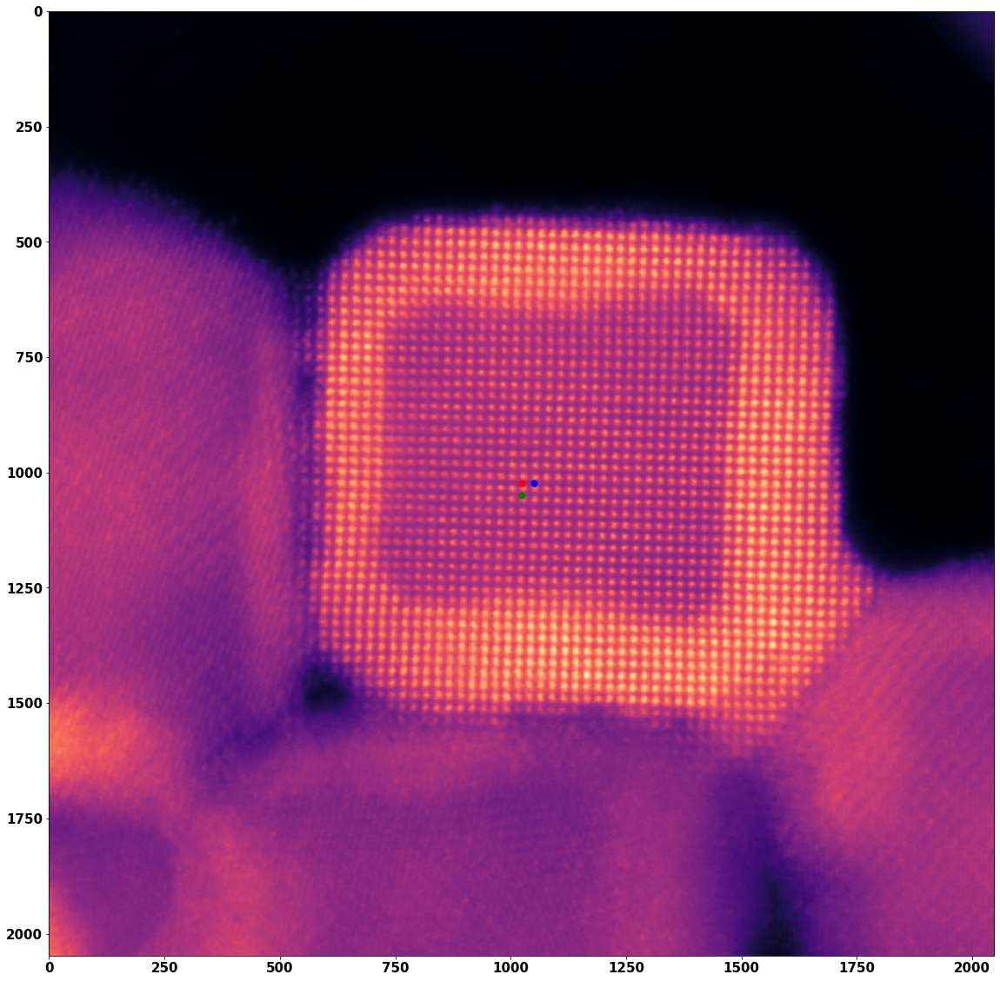

In [62]:
plt.figure(figsize=(20,20))
plt.imshow(image90)
plt.scatter(image90.shape[1]/2,image90.shape[0]/2,c='r', s=50)
plt.scatter(image90.shape[1]/2 + image90_coords[0,1],image90.shape[0]/2 + image90_coords[0,0],c='g', s=50)
plt.scatter(image90.shape[1]/2 + image90_coords[1,1],image90.shape[0]/2 + image90_coords[1,0],c='b', s=50)

In [63]:
axis90_origin = st.afit.get_origin(image90,image90_rpeaks,image90_coords)

In [64]:
st.tic()
image90_neigh, image90_ndist = st.afit.three_neighbors(image90_rpeaks,image90_coords,0.33)
st.toc()

Elapsed time: 0.828137 seconds.



In [65]:
st.tic()
image90_centers, image90_yy,image90_xx,image90_xy,image90_th = st.afit.relative_strain(image90_neigh,image90_coords)
st.toc()

Elapsed time: 0.315701 seconds.



In [66]:
image90_yy = image90_yy - np.median(image90_yy)
image90_xx = image90_xx - np.median(image90_xx)
image90_xy = image90_xy - np.median(image90_xy)
image90_th = image90_th - np.median(image90_th)

In [67]:
st.tic()
strain90_yy,strain90_xx,strain90_xy,strain90_th = st.afit.strain_map(image90_centers,
                                                                     image90_yy,
                                                                     image90_xx, 
                                                                     image90_xy,
                                                                     image90_th,
                                                                     mask00_200)
st.toc()

Elapsed time: 1.293916 seconds.



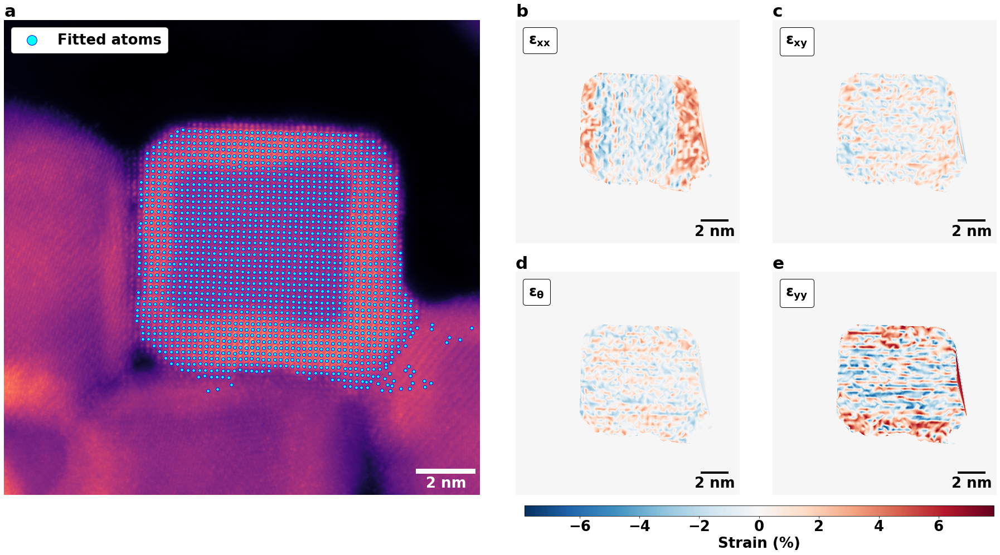

In [77]:
vm = 100*np.amax(np.abs(np.concatenate((strain90_yy,strain90_xx,strain90_xy,strain90_th),axis=1)))
font_size = int(26)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

fig =plt.figure(figsize=(26,13))

gs = mpgs.GridSpec(2, 4)
ax1 = plt.subplot(gs[:, 0:2])
ax2 = plt.subplot(gs[0, 2])
ax3 = plt.subplot(gs[0, 3])
ax4 = plt.subplot(gs[1, 2])
ax5 = plt.subplot(gs[1, 3])

ax1.imshow(image90)
ax1.scatter(image90_rpeaks[:,1],image90_rpeaks[:,0],c='aqua',edgecolors='b',s=35,label='Fitted atoms')
ax1.legend(loc='upper left',markerscale=3,framealpha=1)
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
ax1.add_artist(scalebar)
ax1.set_title(label='a',loc='left',fontdict=title_font)
ax1.axis('off')

im = ax2.imshow(100*strain90_xx,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax2.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{xx}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax2.add_artist(at)
ax2.set_title(label='b',loc='left',fontdict=title_font)
ax2.axis('off')


im = ax3.imshow(100*strain90_xy,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax3.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{xy}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax3.add_artist(at)
ax3.set_title(label='c',loc='left',fontdict=title_font)
ax3.axis('off')


im = ax4.imshow(100*strain90_th,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax4.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{\theta}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax4.add_artist(at)
ax4.set_title(label='d',loc='left',fontdict=title_font)
ax4.axis('off')


im = ax5.imshow(100*strain90_yy,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(calib1,calib1_units)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax5.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{yy}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax5.add_artist(at)
ax5.set_title(label='e',loc='left',fontdict=title_font)
ax5.axis('off')

p4 = ax4.get_position().get_points().flatten()
p5 = ax5.get_position().get_points().flatten()

ax_cbar = fig.add_axes([p4[0] - 0.005, -0.01, 0.5*p5[2], 0.02])
cbar = plt.colorbar(im, cax=ax_cbar, orientation='horizontal')
cbar.set_label('Strain (%)',**sc_font)

plt.tight_layout()
plt.savefig('Results_ADF/Particle1_90_Strain_ACSTEM.pdf',bbox_inches='tight')

In [ ]:
np.savez_compressed('Particle1_ADF.npz',
                    image00=image00,
                    image00_centers=image00_centers,
                    image00_coords=image00_coords,
                    image00_ndist=image00_ndist,
                    image00_neigh=image00_neigh,
                    image00_peaks=image00_peaks,
                    image00_rpeaks=image00_rpeaks,
                    image00_th=image00_th,
                    image00_xx=image00_xx,
                    image00_xy=image00_xy,
                    image00_yy=image00_yy,
                    image90=image90,
                    image90_centers=image90_centers,
                    image90_coords=image90_coords,
                    image90_ndist=image90_ndist,
                    image90_neigh=image90_neigh,
                    image90_peaks=image90_peaks,
                    image90_rpeaks=image90_rpeaks,
                    image90_th=image90_th,
                    image90_xx=image90_xx,
                    image90_xy=image90_xy,
                    image90_yy=image90_yy,
                    imageDC=imageDC,
                    imageDC_centers=imageDC_centers,
                    imageDC_coords=imageDC_coords,
                    imageDC_ndist=imageDC_ndist,
                    imageDC_neigh=imageDC_neigh,
                    imageDC_peaks=imageDC_peaks,
                    imageDC_rpeaks=imageDC_rpeaks,
                    imageDC_th=imageDC_th,
                    imageDC_xx=imageDC_xx,
                    imageDC_xy=imageDC_xy,
                    imageDC_yy=imageDC_yy,
                    strain00_th=strain00_th,
                    strain00_xx=strain00_xx,
                    strain00_xy=strain00_xy,
                    strain00_yy=strain00_yy,
                    strain90_th=strain90_th,
                    strain90_xx=strain90_xx,
                    strain90_xy=strain90_xy,
                    strain90_yy=strain90_yy,
                    strainDC_th=strainDC_th,
                    strainDC_xx=strainDC_xx,
                    strainDC_xy=strainDC_xy,
                    strainDC_yy=strainDC_yy)